In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)

Mounted at /content/gdrive/


In [ ]:
!unzip -q "/content/gdrive/MyDrive/EPAM CV/Week 2. Classification/data/Classification_data.zip"

# Dependencies

In [ ]:
!pip install -q pytorch_lightning
!pip install -q opencv-python-headless==4.1.2.30
!pip install -q albumentations==0.5.2
!pip install -q tensorflow
!pip install -q efficientnet_pytorch

     |████████████████████████████████| 526 kB 4.2 MB/s 
     |████████████████████████████████| 829 kB 52.6 MB/s 
     |████████████████████████████████| 596 kB 50.4 MB/s 
     |████████████████████████████████| 332 kB 57.1 MB/s 
     |████████████████████████████████| 133 kB 57.5 MB/s 
     |████████████████████████████████| 1.1 MB 47.8 MB/s 
     |████████████████████████████████| 271 kB 72.7 MB/s 
     |████████████████████████████████| 160 kB 56.1 MB/s 
     |████████████████████████████████| 192 kB 56.9 MB/s 
     |████████████████████████████████| 21.8 MB 1.3 MB/s 
     |████████████████████████████████| 72 kB 567 kB/s 
     |████████████████████████████████| 948 kB 9.3 MB/s 


In [ ]:
# support
import io
import math
import pickle
import warnings
from pathlib import Path
from typing import Tuple
from functools import partial
from tqdm import tqdm_notebook
from typing import Optional, List, Type, Any
warnings.filterwarnings(action='ignore', category=DeprecationWarning)

In [ ]:
# core
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(style="whitegrid", font_scale=1.4)

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
# vision
import torch
import torch.nn as nn
from torch import Tensor
import torch.nn.functional as F
from torchsummary import summary
from torchvision import transforms, models
from torch.optim import lr_scheduler
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torchmetrics import Accuracy, ConfusionMatrix
from torchmetrics.functional import accuracy

from efficientnet_pytorch import EfficientNet
# torch.use_deterministic_algorithms(True)

from PIL import Image
import albumentations as albu
from albumentations.pytorch import ToTensorV2

In [ ]:
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning import LightningModule, Trainer, seed_everything
from pytorch_lightning.callbacks import LearningRateMonitor
from pytorch_lightning.loggers import TensorBoardLogger

In [ ]:
RANDOM_STATE = 42
pl.utilities.seed.seed_everything(seed=RANDOM_STATE)

Global seed set to 42


42

In [ ]:
%load_ext tensorboard

# Support Functions

In [ ]:
def labels_pathes_dict(train_files, train_labels):
    dict_path = {}
    dict_length = {}
    for label in np.unique(train_labels).tolist():
        dict_path[label] = []
        dict_length[label] = {}

    for path, label in zip(train_files, train_labels):
        dict_path[label].append(path)

    for label in dict_path:
        dict_length[label] = len(dict_path[label])
    df = pd.DataFrame.from_dict(dict_length, orient="index", columns=["count"])
    fig = plt.figure(figsize=(12,5))
    sns.barplot(x="index", y="count", data=df.reset_index())
    plt.title("Distribution of classes")
    plt.show()
    return dict_path

In [ ]:
def per_class_visualization(dict_path, tranformation=False):
    if tranformation:
        transform = Transforms(mode="train", visualization=True)
    nrows = math.ceil(len(dict_path)/3)

    fig, axes = plt.subplots(
        nrows=nrows, ncols=3, 
        figsize=(15, 5*nrows), 
        sharey=True, sharex=True
    )
    axes = axes.flatten()

    for i, label in enumerate(list(dict_path.keys())):
        random_object = int(np.random.uniform(0, len(dict_path[label])))
        im_path, img_label = dict_path[label][random_object], label

        image = np.array(Image.open(im_path))
        if tranformation:
            image = transform(image)
        axes[i].imshow(image)
        axes[i].set_title(img_label)
        axes[i].grid(False)
    plt.tight_layout()
    plt.show()

# Model Functions

## Transformations

In [ ]:
class Transforms:
    def __init__(self, mode="train", visualization=False):
        if mode == "train":
            transforms = [
                albu.LongestMaxSize(max_size=224 + 5, always_apply=True, p=1),
                albu.GridDistortion(distort_limit=0.3, p=0.4),
                # albu.RandomRotate90(p=0.2),
                albu.ColorJitter(hue=0.01, saturation=0.02, p=1),
                albu.ShiftScaleRotate(border_mode=1, rotate_limit=3, p=0.3),
                albu.OneOf(
                    [
                        albu.Blur(blur_limit=3),
                        albu.Downscale(scale_min=0.7, scale_max=0.9),
                    ],
                    p=0.2,
                ),
                albu.PadIfNeeded(
                    min_height=224 + 5,
                    min_width=224 + 5,
                    always_apply=True,
                    border_mode=0,
                    value=(255, 255, 255),
                ),
                albu.RandomCrop(width=224, height=224),
                albu.HorizontalFlip(p=0.5),
                albu.RandomBrightnessContrast(p=0.2),
            ]
        else:
            transforms = [
                albu.LongestMaxSize(max_size=224, always_apply=True, p=1),
                albu.PadIfNeeded(
                    min_height=224,
                    min_width=224,
                    always_apply=True,
                    border_mode=0,
                    value=(255, 255, 255),
                ),
            ]
        if visualization:
            pass
        else:
            transforms.extend(
                [
                    albu.Normalize(),
                    ToTensorV2(),
                ]
            )

        self.transforms = albu.Compose(transforms)

    def __call__(self, img, *args, **kwargs):
        return self.transforms(image=np.array(img))["image"]

In [ ]:
def is_valid_file_function(available_pathes, filename):
    if filename in available_pathes:
        return True
    else:
        return False

## Model

In [ ]:
def conv3x3(
    in_channels: int, 
    out_channels: int, 
    stride: int = 1, 
    groups: int = 1,
    padding: int = 1
) -> nn.Conv2d:

    """3x3 convolution with padding"""
    return nn.Conv2d(
        in_channels,
        out_channels,
        kernel_size=3,
        stride=stride,
        padding=padding,
        groups=groups,
        bias=False
    )

def conv1x1(
    in_channels: int, 
    out_channels: int, 
    stride: int = 1
) -> nn.Conv2d:

    """1x1 convolution"""
    return nn.Conv2d(
        in_channels, 
        out_channels, 
        kernel_size=1, 
        stride=stride, 
        bias=False
    )

In [ ]:
class Bottleneck(nn.Module):

    expansion: int = 4

    def __init__(
        self,
        in_channels: int,
        out_channels: int,
        stride: int = 1,
        downsample: Optional[nn.Module] = None,
        groups: int = 1,
        base_width: int = 64,
    ) -> None:
        super().__init__()

        width = int(out_channels * (base_width / 64.0)) * groups
        # Both self.conv2 and self.downsample layers downsample the input when stride != 1
        self.conv1 = conv1x1(in_channels, width)
        self.bn1 = nn.BatchNorm2d(width)

        self.conv2 = conv3x3(width, width, stride, groups)
        self.bn2 = nn.BatchNorm2d(width)

        self.conv3 = conv1x1(width, out_channels * self.expansion)
        self.bn3 = nn.BatchNorm2d(out_channels * self.expansion)

        self.mish = nn.Mish(inplace=True)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x: Tensor) -> Tensor:
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.mish(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.mish(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.mish(out)

        return out

In [ ]:
class ResNext(nn.Module):
    def __init__(
        self,
        block: Type[Bottleneck],
        layers: List[int],
        num_classes: int = 6,
        groups: int = 32,
        width_per_group: int = 8,
    ) -> None:
        super().__init__()

        self.groups = groups
        self.base_width = width_per_group
        self.in_channels = 64

        # zero layer
        self.conv1 = nn.Conv2d(3, self.in_channels, kernel_size=7, stride=2, padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.mish = nn.Mish(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)

        # other layers
        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2)

        # output FC layer
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(512 * block.expansion, num_classes)

        # parameters init
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode="fan_out", nonlinearity="relu")
            elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

        # Zero-initialize the last BN in each residual branch,
        # so that the residual branch starts with zeros, and each residual block behaves like an identity.
        # This improves the model by 0.2~0.3% according to https://arxiv.org/abs/1706.02677
        for m in self.modules():
            if isinstance(m, Bottleneck):
                nn.init.constant_(m.bn3.weight, 0)  # type: ignore[arg-type]

    def _make_layer(
        self,
        block: Type[Bottleneck],
        out_channels: int,
        blocks: int,
        stride: int = 1,
    ) -> nn.Sequential:

        downsample = None

        if stride != 1 or self.in_channels != out_channels * block.expansion:
            downsample = nn.Sequential(
                conv1x1(in_channels=self.in_channels,
                        out_channels=out_channels * block.expansion,
                        stride=stride),
                nn.BatchNorm2d(out_channels * block.expansion),
            )

        # downsample block
        layers = []
        layers.append(
            block(
                in_channels=self.in_channels, out_channels=out_channels, 
                stride=stride, downsample=downsample, 
                groups=self.groups, base_width=self.base_width
            )
        )

        # aux blocks
        self.in_channels = out_channels * block.expansion
        for _ in range(1, blocks):
            layers.append(
                block(
                    in_channels=self.in_channels,
                    out_channels=out_channels,
                    groups=self.groups,
                    base_width=self.base_width,
                )
            )

        return nn.Sequential(*layers)

    def _forward_impl(self, x: Tensor) -> Tensor:
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.mish(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.fc(x)

        return x

    def forward(self, x: Tensor) -> Tensor:
        return self._forward_impl(x)

In [ ]:
def resnext50_32x4d(
    block: Type[Bottleneck],
    layers: List[int] = [3, 4, 6, 3],
    **kwargs: Any
) -> ResNext:
    kwargs["groups"] = 32
    kwargs["width_per_group"] = 4
    model = ResNext(block=Bottleneck, layers=layers, **kwargs)
    return model

In [ ]:
def weights_init(m):
    if isinstance(m, nn.Conv2d):
        xavier(m.weight.data)
        xavier(m.bias.data)

## Pytorch Lighting Functions

In [ ]:
class Runner(pl.LightningModule):
    def __init__(self, model, classes: list, lr: float = 1e-3, 
                 scheduler_T=1000, chunked_optimizer=False) -> None:
        super().__init__()
        self.chunked_optimizer = chunked_optimizer
        self.save_hyperparameters()
        self.model = model
        self.lr = lr
        self.scheduler_T = scheduler_T
        self.criterion = nn.CrossEntropyLoss()
        self.classes = classes

        self.metrics = torch.nn.ModuleDict(
            {
                "accuracy": Accuracy(
                    num_classes=6, compute_on_step=False, average="macro"
                ),
                "confusion_matrix": ConfusionMatrix(
                    num_classes=6, normalize="true", compute_on_step=False
                ),
            }
        )

    def forward(self, x):
        out = self.model(x)
        return out # F.softmax(out, dim=1)


    def training_step(
        self,
        batch: Tuple[torch.Tensor, torch.Tensor],
        batch_idx
    ) -> torch.Tensor:
        images, target = batch
        logits = self(images.float())
        loss = self.criterion(logits, target)

        self.log("Train/Loss", loss.item(), on_step=True, batch_size=BATCH_SIZE)
        self.log(
            "Train/LR",
            self.lr_schedulers().get_last_lr()[0],
            on_step=True,
            batch_size=BATCH_SIZE,
        )

        return loss

    def validation_step(
        self, 
        batch: Tuple[torch.Tensor, torch.Tensor], 
        batch_idx
    ) -> torch.Tensor:

        images, target = batch
        logits = self(images.float())
        loss = self.criterion(logits, target)
        for metric in self.metrics.values():
            metric(logits.argmax(dim=-1), target)

        self.log(
            "Validation/Classification Loss",
            loss.item(),
            on_step=True,
            batch_size=BATCH_SIZE,
        )

        return loss

    def validation_epoch_end(self, something) -> None:
        for name, metric in self.metrics.items():
            metric_val = metric.compute()
            self.log(f"Validation/{name}", metric_val, on_step=False, on_epoch=True)
            metric.reset()
            if name != "confusion_matrix":
                print(f"Validation {name} = {metric_val}")
            else:
                self.log_cm(metric_val)
    
    def log_cm(self, confusion_matrix):
        plt.figure(figsize=(12, 12))
        sns.heatmap(
            np.around(confusion_matrix.cpu().numpy(), 3),
            annot=True,
            cmap="YlGnBu",
            xticklabels=self.classes,
            yticklabels=self.classes,
        )
        buf = io.BytesIO()
        plt.savefig(buf)
        buf.seek(0)
        image = np.array(Image.open(buf))[:, :, :3]
        buf.close()
        plt.clf()
        plt.close()
        self.logger.experiment.add_image(
            "conf_matr", image, self.current_epoch, dataformats="HWC"
        )

    def evaluate(self, batch, stage=None):
        images, target = batch
        logits = self(images.float())
        loss = self.criterion(logits, target)
        preds = torch.argmax(logits, dim=1)
        acc = accuracy(preds, target)

        if stage:
            self.log(f"{stage}_loss", loss, prog_bar=True)
            self.log(f"{stage}_acc", acc, prog_bar=True)

    def test_step(self, batch, batch_idx):
        self.evaluate(batch, "test")

    def chunks(lst, chunk_count):
        chunk_size = len(lst) // chunk_count
        chunk = [np.array(lst[i:i+chunk_size]) for i in range(0, len(lst), chunk_size)]
        return chunk

    def configure_optimizers(self):

        steps_per_epoch = 6000 // BATCH_SIZE

        if self.chunked_optimizer:
            amount = len(list(self.model.parameters()))

            for i, param in enumerate(self.model.parameters()):
                if (i+1) / amount < 0.5:
                    param.requires_grad = False
                    last = i + 2
            
            param_chunk = chunks(lst=list(range(last, amount+1)), chunk_count=4)

            param1 = list(self.model.parameters())[param_chunk[0][0]:param_chunk[0][-1]+1]
            param2 = list(self.model.parameters())[param_chunk[1][0]:param_chunk[1][-1]+1]
            param3 = list(self.model.parameters())[param_chunk[2][0]:param_chunk[2][-1]+1]
            param4 = list(self.model.parameters())[param_chunk[3][0]:param_chunk[3][-1]+1]

            optimizer = torch.optim.Adam(params = [
                {'params': param1, 'lr': self.lr / 50},
                {'params': param2, 'lr': self.lr / 10},
                {'params': param3, 'lr': self.lr / 5},
                {'params': param4, 'lr': self.lr}], 
                lr=self.lr, amsgrad=True)
            
        else:
            params = list(filter(lambda p: p.requires_grad, self.model.parameters()))
            optimizer = torch.optim.Adam(params, lr=self.lr)
        

        scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
            optimizer=optimizer, T_max=self.scheduler_T, eta_min=1e-7
        )

        scheduler_dict = {
            "scheduler": scheduler,
            "interval": "step",
        }

        return {"optimizer": optimizer, "lr_scheduler": scheduler_dict}

In [ ]:
EPOCHS = 25

def define_job(
    model,
    len_train_dl: int,  # = len(train_dl),
    classes: list,  # = val_dataset.classes,
    lr: float = 1e-4,
    epochs: int = EPOCHS,
    model_name: str = "resnet",
    chunked_optimizer=False
):

    trainer = Trainer(
        progress_bar_refresh_rate=10,
        max_epochs=epochs,
        gpus=-1,
        logger=TensorBoardLogger("/content/gdrive/MyDrive/EPAM CV/Week 2. Classification/lightning_logs/" + model_name + "/", name="tensorboard"),
        callbacks=[
            ModelCheckpoint(
                dirpath="/content/gdrive/MyDrive/EPAM CV/Week 2. Classification/lightning_logs/" + model_name + "/" + "checkpoints/",
                save_top_k=1,  # -1,
                verbose=True,
                filename="checkpoint-{epoch:02d}",
            ),
            LearningRateMonitor(logging_interval="step")
        ],
    )

    runner = Runner(
        model=model,
        lr=1e-4,
        scheduler_T=epochs * len_train_dl,
        classes=classes,
        chunked_optimizer=chunked_optimizer
        )
    

    return runner, trainer

# Explore Dataset

In [ ]:
# check gpu availability
train_on_gpu = torch.cuda.is_available()
if not train_on_gpu:
    print('CUDA is not available.  Training on CPU ...')
else:
    print('CUDA is available!  Training on GPU ...')
    !nvidia-smi

# determine the device
DEVICE = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

CUDA is available!  Training on GPU ...
Thu Jan 13 11:07:52 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.46       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    28W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                

In [ ]:
# Main folder 
dataset_folder_to_use = Path("/content/Classification_data")

# dataset modes 
DATA_MODES = ['train', 'val', 'test']

# pathes to dirs
TRAIN_DIR = dataset_folder_to_use / 'train'
TEST_DIR = dataset_folder_to_use / 'test'

# pathes to images
train_val_files = sorted(list(TRAIN_DIR.rglob('*.jpg')))
test_files = sorted(list(TEST_DIR.rglob('*.jpg')))

# labels
train_val_labels = [path.parent.name for path in train_val_files]
n_classes = len(np.unique(train_val_labels))

# train/val slit
train_files, val_files, train_labels, val_labels = train_test_split(
    train_val_files, 
    train_val_labels, 
    test_size=0.25, 
    stratify=train_val_labels
)

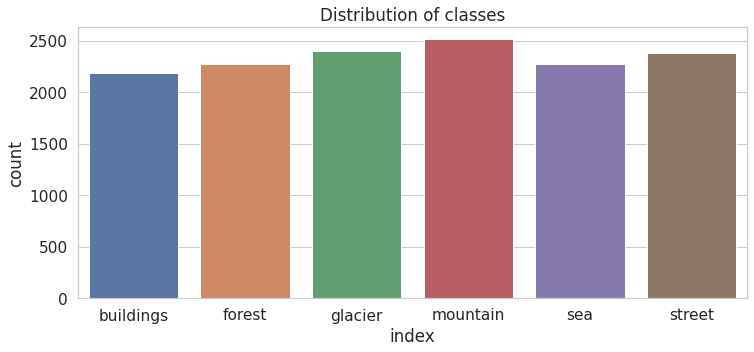

In [ ]:
dict_path = labels_pathes_dict(train_val_files, train_val_labels)

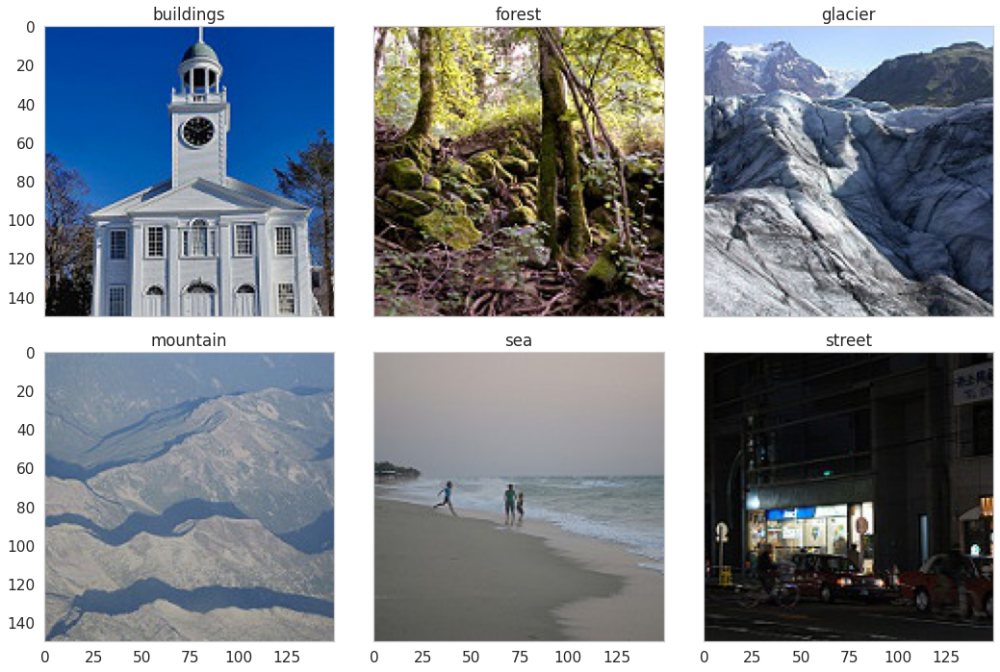

In [ ]:
per_class_visualization(dict_path, tranformation=False)

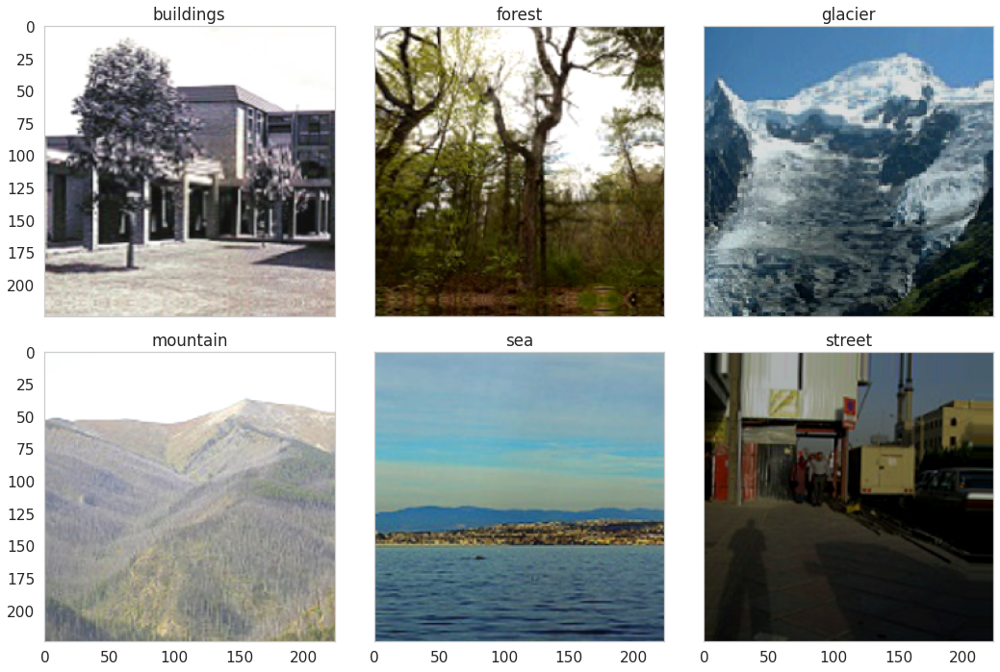

In [ ]:
per_class_visualization(dict_path, tranformation=True)

# Set up

## Define the model

In [ ]:
resnet = resnext50_32x4d(Bottleneck, layers=[3, 4, 6, 3])
resnet.apply(weights_init)
resnet = resnet.to(DEVICE)

In [ ]:
# summary(resnet, (3, 224, 224), batch_size=32)

In [ ]:
efficient = EfficientNet.from_pretrained('efficientnet-b1', num_classes=6)
efficient = efficient.to(DEVICE)

Loaded pretrained weights for efficientnet-b1


## Define datasets

In [ ]:
# pathes available for train dataset
train_valid = partial(is_valid_file_function, [Path(_).name for _ in train_files])

# pathes available for val dataset
val_valid = partial(is_valid_file_function, [Path(_).name for _ in val_files])

# https://pytorch.org/vision/stable/datasets.html
# https://pytorch.org/vision/stable/_modules/torchvision/datasets/folder.html#ImageFolder

train_dataset = ImageFolder(
    root=str(dataset_folder_to_use / "train"),
    transform=Transforms(),
    is_valid_file=train_valid
)

val_dataset = ImageFolder(
    root=str(dataset_folder_to_use / "train"),
    transform=Transforms(mode="val"),
    is_valid_file=val_valid
)

test_dataset = ImageFolder(
    root=str(dataset_folder_to_use / "test"),
    transform=Transforms(mode="test")
)


## Define dataloaders

In [ ]:
BATCH_SIZE = 48

train_dl = DataLoader(
    train_dataset,
    BATCH_SIZE,
    shuffle=True,
    pin_memory=False,
    num_workers=4,
    drop_last=True,
)

val_dl = DataLoader(
    val_dataset,
    BATCH_SIZE,
    pin_memory=False,
    shuffle=False,
    num_workers=4,
    drop_last=False,
)

test_dl = DataLoader(
    test_dataset,
    BATCH_SIZE,
    pin_memory=False,
    shuffle=False,
    num_workers=4,
    drop_last=False,
)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


# Run ResNet

In [ ]:
runner_resnet, trainer_resnet = define_job(
    model=resnet,
    len_train_dl=len(train_dl),
    classes=val_dataset.classes
    )

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/connectors/callback_connector.py:91: LightningDeprecationWarning: Setting `Trainer(progress_bar_refresh_rate=10)` is deprecated in v1.5 and will be removed in v1.7. Please pass `pytorch_lightning.callbacks.progress.TQDMProgressBar` with `refresh_rate` directly to the Trainer's `callbacks` argument instead. Or, to disable the progress bar pass `enable_progress_bar = False` to the Trainer.
  f"Setting `Trainer(progress_bar_refresh_rate={progress_bar_refresh_rate})` is deprecated in v1.5 and"
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


In [ ]:
trainer_resnet.fit(runner_resnet, train_dl, val_dl)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type             | Params
-----------------------------------------------
0 | model     | ResNext          | 23.0 M
1 | criterion | CrossEntropyLoss | 0     
2 | metrics   | ModuleDict       | 0     
-----------------------------------------------
23.0 M    Trainable params
0         Non-trainable params
23.0 M    Total params
91.969    Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Validation accuracy = 0.0


/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: 30 nan values found in confusion matrix have been replaced with zeros.
  warnings.warn(*args, **kwargs)


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.6188772320747375


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.7041560411453247


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.7372493743896484


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.7556092739105225


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.7534021139144897


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8071658611297607


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8050962686538696


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8143421411514282


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.839867115020752


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8436615467071533


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8456039428710938


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8568050265312195


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8487563729286194


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8680989742279053


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8536887168884277


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8651024103164673


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8786950707435608


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8687089085578918


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8803839683532715


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8815336227416992


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8808447122573853


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8843363523483276


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8858120441436768


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.88620525598526


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.884545087814331


In [ ]:
%tensorboard --logdir "/content/gdrive/MyDrive/EPAM CV/Week 2. Classification/lightning_logs/resnet/tensorboard"

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
trainer_resnet.test(dataloaders=test_dl)

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1399: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.checkpoint_callback.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at /content/gdrive/MyDrive/EPAM CV/Week 2. Classification/lightning_logs/resnet/checkpoints/checkpoint-epoch=24.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /content/gdrive/MyDrive/EPAM CV/Week 2. Classification/lightning_logs/resnet/checkpoints/checkpoint-epoch=24.ckpt


Testing: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_acc': 0.8806666731834412, 'test_loss': 0.34519344568252563}
--------------------------------------------------------------------------------


[{'test_acc': 0.8806666731834412, 'test_loss': 0.34519344568252563}]

In [ ]:
# train_predictions = trainer_resnet.predict(dataloaders=train_dl)
# test_predictions = trainer_resnet.predict(dataloaders=test_dl)

# Run Efficient Net

In [ ]:
runner_efficient, trainer_efficient = define_job(
    model=efficient,
    len_train_dl=len(train_dl),
    classes=val_dataset.classes,
    model_name="efficient"
    )

trainer_efficient.fit(runner_efficient, train_dl, val_dl)

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/connectors/callback_connector.py:91: LightningDeprecationWarning: Setting `Trainer(progress_bar_refresh_rate=10)` is deprecated in v1.5 and will be removed in v1.7. Please pass `pytorch_lightning.callbacks.progress.TQDMProgressBar` with `refresh_rate` directly to the Trainer's `callbacks` argument instead. Or, to disable the progress bar pass `enable_progress_bar = False` to the Trainer.
  f"Setting `Trainer(progress_bar_refresh_rate={progress_bar_refresh_rate})` is deprecated in v1.5 and"
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type             | Params
-----------------------------------------------
0 | model     | EfficientNet     | 6.5 M 
1 | criterion | CrossEntropyLoss | 0     
2 | metrics   | ModuleDict       | 0     
-----------------------------------------------
6.5 M     Trainable para

Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Validation accuracy = 0.0833333358168602


/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: 30 nan values found in confusion matrix have been replaced with zeros.
  warnings.warn(*args, **kwargs)


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9253017902374268


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9279857277870178


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9298897385597229


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9364261031150818


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9368914365768433


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9390132427215576


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9389567375183105


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9420946836471558


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9407874345779419


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9423369765281677


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.941482424736023


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9418767690658569


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9414722323417664


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9398818016052246


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9384790658950806


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.941657304763794


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9412354230880737


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9406692981719971


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9419376850128174


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9421844482421875


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9435554146766663


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9436134099960327


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9433582425117493


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9431070685386658


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9433724284172058


In [ ]:
%tensorboard --logdir "/content/gdrive/MyDrive/EPAM CV/Week 2. Classification/lightning_logs/efficient/tensorboard"

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
trainer_efficient.test(dataloaders=test_dl)

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1399: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.checkpoint_callback.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at /content/gdrive/MyDrive/EPAM CV/Week 2. Classification/lightning_logs/efficient/checkpoints/checkpoint-epoch=24.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /content/gdrive/MyDrive/EPAM CV/Week 2. Classification/lightning_logs/efficient/checkpoints/checkpoint-epoch=24.ckpt


Testing: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_acc': 0.9413333535194397, 'test_loss': 0.19605638086795807}
--------------------------------------------------------------------------------


[{'test_acc': 0.9413333535194397, 'test_loss': 0.19605638086795807}]

# Run Efficient Net with chuncked_opt

In [ ]:
runner_efficient, trainer_efficient = define_job(
    model=efficient,
    len_train_dl=len(train_dl),
    classes=val_dataset.classes,
    model_name="efficient",
    chunked_optimizer=True
    )

trainer_efficient.fit(runner_efficient, train_dl, val_dl)

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/connectors/callback_connector.py:91: LightningDeprecationWarning: Setting `Trainer(progress_bar_refresh_rate=10)` is deprecated in v1.5 and will be removed in v1.7. Please pass `pytorch_lightning.callbacks.progress.TQDMProgressBar` with `refresh_rate` directly to the Trainer's `callbacks` argument instead. Or, to disable the progress bar pass `enable_progress_bar = False` to the Trainer.
  f"Setting `Trainer(progress_bar_refresh_rate={progress_bar_refresh_rate})` is deprecated in v1.5 and"
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type             | Params
-----------------------------------------------
0 | model     | EfficientNet     | 6.5 M 
1 | criterion | CrossEntropyLoss | 0     
2 | metrics   | ModuleDict       | 0     
-----------------------------------------------
6.1 M     Trainable para

Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Validation accuracy = 0.014583333395421505


/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: 30 nan values found in confusion matrix have been replaced with zeros.
  warnings.warn(*args, **kwargs)


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.8967176079750061


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9191216230392456


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9263922572135925


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9247128963470459


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9277662038803101


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9305267930030823


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9329465627670288


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9320146441459656


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9322006702423096


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9343913793563843


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9362088441848755


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9374822974205017


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9356815218925476


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.938464879989624


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9373500943183899


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9381508827209473


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9380146265029907


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9384284615516663


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.939203143119812


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9401233196258545


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9378345012664795


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9389729499816895


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9385697841644287


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9383915066719055


Validating: 0it [00:00, ?it/s]

Validation accuracy = 0.9379656910896301
